# Pokemon Generation with GANs

This code aims to train a DCGAN to generate images of Pokemons. Utilizing the classis DCGAN architecutre from https://arxiv.org/abs/1511.06434.

Issues:
* Only 1 image per Pokemon.
* Pokemons are very different from each other. (Compared to animals within species)
* The network impolodes randomly after 200 epochs.
* The output resolution is small.

Future upgrades:
* Try P100 instead of T4
* Expand the dataset with data augmentation.
* Spectral normalization
* Changing the loss function to Earth Movers Distace
* Implementing BIGGAN architecture.

Tried:
* Increasing DataLoaders to speed up trainig. (Doesn't seem to make a difference.)
* Increasing Output res and mapsize. (Leads to faster exploding gradients)

In [1]:
!pip install wandb

In [2]:
#%matplotlib inline
import argparse
import os
import random
import time
from pathlib import Path
from PIL import Image
import torch
import torch.nn as nn
import torch.nn.parallel
import torch.optim as optim
import torch.utils.data
import torchvision.datasets as dset
import torchvision.transforms as transforms
import torchvision.utils as vutils
from torch.nn.utils import spectral_norm
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.animation as animation
import wandb
from IPython.display import HTML

# Set random seed for reproducibility
manualSeed = 999
# manualSeed = random.randint(1, 10000) # use if you want new results
print("Random Seed: ", manualSeed)
random.seed(manualSeed)
torch.manual_seed(manualSeed)
# torch.use_deterministic_algorithms(True) # Needed for reproducible results

Random Seed:  999


# Exploring the data

In [3]:
def get_resolution(filename):
    with Image.open(filename) as img:
        return img.size

img_path = Path('/kaggle/input/pokemon-images-and-types/images')
img_data = []
for filename in os.listdir(img_path):
    if filename.endswith('.png'):
        path = img_path / filename
        size = path.stat().st_size
        resolution = get_resolution(path)
        img_data.append({'filename': filename, 'size': size, 'resolution': resolution})

df = pd.DataFrame(img_data)

In [4]:
# confirming all images are the same size
print(df.iloc[:,2].unique())

# estimating required memory for the whole dataset
print(df.iloc[:, 1].sum())

[(120, 120)]
3755593


Dataset parameters

In [5]:
wandb.init(project="Pokemon GAN",
          config= {
              "learning_rate": 0.0002,
              "epochs": 1000,
              "batch_size": 64,
              "DL_workers": 4,
              "gen_map_size": 64,
              "disc_map_size": 64,
              "Adam beta1": 0.5,
              "image_size": 64
          })

# Root directory for dataset
img_path = Path('/kaggle/input/pokemon-images-and-types')

# Number of workers for dataloader
workers = wandb.config['DL_workers']

# Batch size during training
batch_size = wandb.config['batch_size']

# Spatial size of training images. All images will be resized to this
#   size using a transformer.
image_size = wandb.config['image_size']

# Number of channels in the training images. For color images this is 3
nc = 3

# Size of z latent vector (i.e. size of generator input)
nz = 100

# Size of feature maps in generator
ngf = wandb.config['gen_map_size']

# Size of feature maps in discriminator
ndf = wandb.config['disc_map_size']

# Number of training epochs
num_epochs = wandb.config['epochs']

# Learning rate for optimizers
lr = wandb.config['learning_rate']

# Beta1 hyperparameter for Adam optimizers
beta1 = wandb.config['Adam beta1']

# Number of GPUs available. Use 0 for CPU mode.
ngpu = 1

wandb: Logging into wandb.ai. (Learn how to deploy a W&B server locally: https://wandb.me/wandb-server)
wandb: You can find your API key in your browser here: https://wandb.ai/authorize
wandb: Paste an API key from your profile and hit enter, or press ctrl+c to quit:

  ········································


wandb: Appending key for api.wandb.ai to your netrc file: /root/.netrc


In [ ]:
# Prepare transforms
reg_tranform = transforms.Compose([
   transforms.Resize(image_size),
   transforms.CenterCrop(image_size),
   transforms.ToTensor(),
   transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5)),
])

aug_tranform = transforms.Compose([
    transforms.RandomHorizontalFlip(p=0.5),  
    transforms.RandomVerticalFlip(p=0.5),  
    transforms.RandomRotation(degrees=(0,180)),
    transforms.ColorJitter(brightness=(0.5,2), contrast=(0.5,2), saturation=(0.5,2), hue=(-0.5, 0.5)),
    transforms.Resize(image_size),
    transforms.CenterCrop(image_size),
    transforms.ToTensor(),
    transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5)),
])

# Create the dataset
dataset_no_aug = dset.ImageFolder(
    root=img_path,
    transform=reg_tranform
)

dataset_aug_1 = dset.ImageFolder(
    root=img_path,
    transform=aug_tranform
)

dataset_aug_2 = dset.ImageFolder(
    root=img_path,
    transform=aug_tranform
)

dataset = torch.utils.data.ConcatDataset([dataset_no_aug, dataset_aug_1, dataset_aug_2])

# Create the dataloader
dataloader = torch.utils.data.DataLoader(dataset, batch_size=batch_size,
                                         shuffle=True, num_workers=workers,
                                        pin_memory=True)

# Decide which device we want to run on
device = torch.device("cuda:0" if (torch.cuda.is_available() and ngpu > 0) else "cpu")

# Plot some training images
real_batch = next(iter(dataloader))
plt.figure(figsize=(8,8))
plt.axis("off")
plt.title("Training Images")
plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device)[:64], padding=2, normalize=True).cpu(),(1,2,0)))
plt.show()

# Model creation

In [15]:
# Generator Code
class Generator(nn.Module):
    def __init__(self, ngpu):
        super(Generator, self).__init__()
        self.ngpu = ngpu
        self.main = nn.Sequential(
            # input is Z, going into a convolution
            nn.ConvTranspose2d( nz, ngf * 8, 4, 1, 0, bias=False),
            nn.BatchNorm2d(ngf * 8),
            nn.ReLU(True),
            # state size. ``(ngf*8) x 4 x 4``
            nn.ConvTranspose2d(ngf * 8, ngf * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf * 4),
            nn.ReLU(True),
            # state size. ``(ngf*4) x 8 x 8``
            nn.ConvTranspose2d( ngf * 4, ngf * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf * 2),
            nn.ReLU(True),
            # state size. ``(ngf*2) x 16 x 16``
            nn.ConvTranspose2d( ngf * 2, ngf, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf),
            nn.ReLU(True),
            # state size. ``(ngf) x 32 x 32``
            nn.ConvTranspose2d( ngf, nc, 4, 2, 1, bias=False),
            nn.Tanh()
            # state size. ``(nc) x 64 x 64``
        )
    
#     def ResBlock():
#         nn.

    def forward(self, input):
        return self.main(input)

In [16]:
class Discriminator(nn.Module):
    def __init__(self, ngpu):
        super(Discriminator, self).__init__()
        self.ngpu = ngpu
        self.main = nn.Sequential(
            # input is ``(nc) x 64 x 64``
            spectral_norm(nn.Conv2d(nc, ndf, 4, 2, 1, bias=False)),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. ``(ndf) x 32 x 32``
            spectral_norm(nn.Conv2d(ndf, ndf * 2, 4, 2, 1, bias=False)),
            nn.BatchNorm2d(ndf * 2),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. ``(ndf*2) x 16 x 16``
            spectral_norm(nn.Conv2d(ndf * 2, ndf * 4, 4, 2, 1, bias=False)),
            nn.BatchNorm2d(ndf * 4),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. ``(ndf*4) x 8 x 8``
            spectral_norm(nn.Conv2d(ndf * 4, ndf * 8, 4, 2, 1, bias=False)),
            nn.BatchNorm2d(ndf * 8),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. ``(ndf*8) x 4 x 4``
            spectral_norm(nn.Conv2d(ndf * 8, 1, 4, 1, 0, bias=False)),
            nn.Sigmoid()
        )
        
    def ResBlock(x):
        z0 = nn.Conv2d(x, )
        z1 = nn.ReLU()
        

    def forward(self, input):
        return self.main(input)

In [17]:
# custom weights initialization called on ``netG`` and ``netD``
def weights_init(m):
    classname = m.__class__.__name__
    if classname.find('Conv') != -1:
        nn.init.normal_(m.weight.data, 0.0, 0.02)
    elif classname.find('BatchNorm') != -1:
        nn.init.normal_(m.weight.data, 1.0, 0.02)
        nn.init.constant_(m.bias.data, 0)

# Training

In [23]:
# Create the generator
netG = Generator(ngpu).to(device)

# Handle multi-GPU if desired
if (device.type == 'cuda') and (ngpu > 1):
    netG = nn.DataParallel(netG, list(range(ngpu)))

# Apply the ``weights_init`` function to randomly initialize all weights
#  to ``mean=0``, ``stdev=0.02``.
netG.apply(weights_init)

# Print the model
print(netG)

Generator(
  (main): Sequential(
    (0): ConvTranspose2d(100, 512, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (1): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace=True)
    (3): ConvTranspose2d(512, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (4): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (5): ReLU(inplace=True)
    (6): ConvTranspose2d(256, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (7): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (8): ReLU(inplace=True)
    (9): ConvTranspose2d(128, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (10): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (11): ReLU(inplace=True)
    (12): ConvTranspose2d(64, 3, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (13): Tanh()
  )
)


In [24]:
# Create the Discriminator
netD = Discriminator(ngpu).to(device)

# Handle multi-GPU if desired
if (device.type == 'cuda') and (ngpu > 1):
    netD = nn.DataParallel(netD, list(range(ngpu)))

# Apply the ``weights_init`` function to randomly initialize all weights
# like this: ``to mean=0, stdev=0.2``.
netD.apply(weights_init)

# Print the model
print(netD)

Discriminator(
  (main): Sequential(
    (0): Conv2d(3, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (1): LeakyReLU(negative_slope=0.2, inplace=True)
    (2): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (3): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (4): LeakyReLU(negative_slope=0.2, inplace=True)
    (5): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (6): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (7): LeakyReLU(negative_slope=0.2, inplace=True)
    (8): Conv2d(256, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (9): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (10): LeakyReLU(negative_slope=0.2, inplace=True)
    (11): Conv2d(512, 1, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (12): Sigmoid()
  )
)


In [25]:
# Initialize the ``BCELoss`` function
criterion = nn.BCELoss()

# Create batch of latent vectors that we will use to visualize
#  the progression of the generator
fixed_noise = torch.randn(64, nz, 1, 1, device=device)

# Establish convention for real and fake labels during training
real_label = 1.
fake_label = 0.

# Setup Adam optimizers for both G and D
optimizerD = optim.Adam(netD.parameters(), lr=lr, betas=(beta1, 0.999))
optimizerG = optim.Adam(netG.parameters(), lr=lr, betas=(beta1, 0.999))

In [26]:
# Training Loop

# Lists to keep track of progress
img_list = []
G_losses = []
D_losses = []
iters = 0

print("Starting Training Loop...")
start_time = time.time()
# For each epoch
for epoch in range(num_epochs):
    # For each batch in the dataloader
    for i, data in enumerate(dataloader, 0):

        ############################
        # (1) Update D network: maximize log(D(x)) + log(1 - D(G(z)))
        ###########################
        ## Train with all-real batch
        netD.zero_grad()
        # Format batch
        real_cpu = data[0].to(device)
        b_size = real_cpu.size(0)
        label = torch.full((b_size,), real_label, dtype=torch.float, device=device)
        # Forward pass real batch through D
        output = netD(real_cpu).view(-1)
        # Calculate loss on all-real batch
        errD_real = criterion(output, label)
        # Calculate gradients for D in backward pass
        errD_real.backward()
        D_x = output.mean().item()

        ## Train with all-fake batch
        # Generate batch of latent vectors
        noise = torch.randn(b_size, nz, 1, 1, device=device)
        # Generate fake image batch with G
        fake = netG(noise)
        label.fill_(fake_label)
        # Classify all fake batch with D
        output = netD(fake.detach()).view(-1)
        # Calculate D's loss on the all-fake batch
        errD_fake = criterion(output, label)
        # Calculate the gradients for this batch, accumulated (summed) with previous gradients
        errD_fake.backward()
        D_G_z1 = output.mean().item()
        # Compute error of D as sum over the fake and the real batches
        errD = errD_real + errD_fake
        # Update D
        optimizerD.step()

        ############################
        # (2) Update G network: maximize log(D(G(z)))
        ###########################
        netG.zero_grad()
        label.fill_(real_label)  # fake labels are real for generator cost
        # Since we just updated D, perform another forward pass of all-fake batch through D
        output = netD(fake).view(-1)
        # Calculate G's loss based on this output
        errG = criterion(output, label)
        # Calculate gradients for G
        errG.backward()
        D_G_z2 = output.mean().item()
        # Update G
        optimizerG.step()

        # Output training stats
        if i % 50 == 0:
            print('[%d/%d][%d/%d]\tLoss_D: %.4f\tLoss_G: %.4f\tD(x): %.4f\tD(G(z)): %.4f / %.4f'
                  % (epoch, num_epochs, i, len(dataloader),
                     errD.item(), errG.item(), D_x, D_G_z1, D_G_z2))

        # Save Losses for plotting later
        G_losses.append(errG.item())
        D_losses.append(errD.item())

        # Check how the generator is doing by saving G's output on fixed_noise
        if (iters % 200 == 0) or ((epoch == num_epochs-1) and (i == len(dataloader)-1)):
            with torch.no_grad():
                fake = netG(fixed_noise).detach().cpu()
            img_list.append(vutils.make_grid(fake, padding=2, normalize=True))
            
            torch.save({
                'epoch': epoch,
                'gen_state_dict': netG.state_dict(),
                'gen_optimizer_state_dict': optimizerG.state_dict(),
                'gen_loss': errG,
                }, f'/kaggle/working/gen_model{epoch}.pt')
    
            torch.save({
                'epoch': epoch,
                'desc_state_dict': netD.state_dict(),
                'desc_optimizer_state_dict': optimizerD.state_dict(),
                'desc_loss': errD,
                }, f'/kaggle/working/desc_model{epoch}.pt')

        iters += 1
    
    wandb.log({"epoch":epoch,
              "Discriminator Loss": errD.item(),
              "Generator Loss": errG.item()})

end_time = time.time()
duration = end_time - start_time

print("Training took {:.2f} seconds".format(duration))

wandb.log({"Training time": duration})

Starting Training Loop...
[0/1000][0/38]	Loss_D: 1.5035	Loss_G: 4.6333	D(x): 0.5221	D(G(z)): 0.5343 / 0.0112
[1/1000][0/38]	Loss_D: 0.2772	Loss_G: 21.4547	D(x): 0.8722	D(G(z)): 0.0000 / 0.0000
[2/1000][0/38]	Loss_D: 0.4014	Loss_G: 3.2936	D(x): 0.7612	D(G(z)): 0.0674 / 0.0749
[3/1000][0/38]	Loss_D: 0.2169	Loss_G: 4.6013	D(x): 0.9032	D(G(z)): 0.0672 / 0.0166
[4/1000][0/38]	Loss_D: 0.7783	Loss_G: 7.0225	D(x): 0.8905	D(G(z)): 0.4184 / 0.0015
[5/1000][0/38]	Loss_D: 0.1280	Loss_G: 4.3349	D(x): 0.9275	D(G(z)): 0.0476 / 0.0188
[6/1000][0/38]	Loss_D: 0.1720	Loss_G: 4.5464	D(x): 0.9069	D(G(z)): 0.0595 / 0.0146
[7/1000][0/38]	Loss_D: 0.1301	Loss_G: 5.5741	D(x): 0.9077	D(G(z)): 0.0257 / 0.0054
[8/1000][0/38]	Loss_D: 0.2245	Loss_G: 5.5991	D(x): 0.9735	D(G(z)): 0.1704 / 0.0052
[9/1000][0/38]	Loss_D: 0.3106	Loss_G: 3.6539	D(x): 0.8997	D(G(z)): 0.1653 / 0.0331
[10/1000][0/38]	Loss_D: 0.6078	Loss_G: 5.3858	D(x): 0.9555	D(G(z)): 0.3853 / 0.0087
[11/1000][0/38]	Loss_D: 0.2675	Loss_G: 6.1848	D(x): 0.7881	

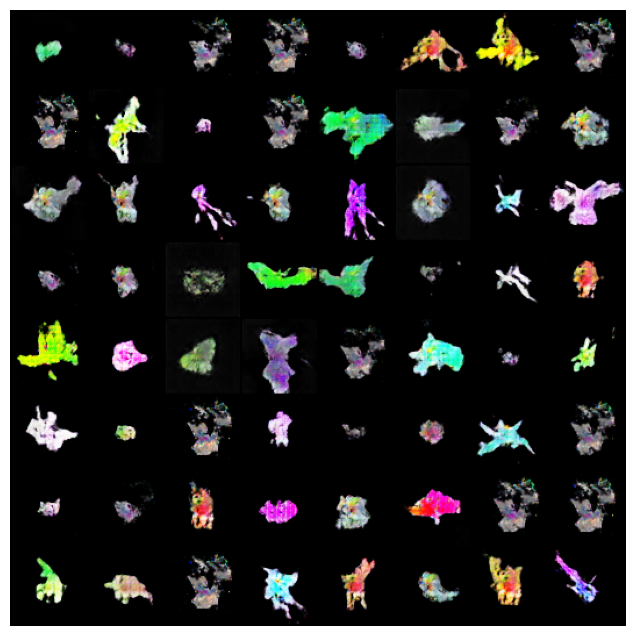

In [27]:
fig = plt.figure(figsize=(8,8))
plt.axis("off")
ims = [[plt.imshow(np.transpose(i,(1,2,0)), animated=True)] for i in img_list]
ani = animation.ArtistAnimation(fig, ims, interval=1000, repeat_delay=5000, blit=True)

HTML(ani.to_jshtml())

In [ ]:
ani.save(filename="/kaggle/working/pokemon.mp4", writer="ffmpeg")
ani.save(filename="/kaggle/working/pokemon.gif", writer="pillow")
ani.save(filename="/kaggle/working/pokemon.apng", writer="pillow")
ani.save(filename="/kaggle/working/pokemon.gif", writer="pillow")